C:\Users\Alex\AppData\Local\Temp\ipykernel_30004\4224271249.py:38: DtypeWarning:

Columns (29) have mixed types. Specify dtype option on import or set low_memory=False.



Columnas iniciales: ['country', 'year', 'sex', 'age', 'suicides_no', 'population', 'suicides/100k pop', 'country-year', 'HDI for year', 'gdp_for_year ($)', 'gdp_per_capita ($)', 'generation', 'HDI_for_year_imputed', 'country_prueba', 'country_std', 'Country', 'Region', 'Population', 'Area (sq. mi.)', 'Pop. Density (per sq. mi.)', 'Coastline (coast/area ratio)', 'Net migration', 'Infant mortality (per 1000 births)', 'GDP ($ per capita)', 'Literacy (%)', 'Phones (per 1000)', 'Arable (%)', 'Crops (%)', 'Other (%)', 'Climate', 'Birthrate', 'Deathrate', 'Agriculture', 'Industry', 'Service', 'Country_clean', 'Climate_merged']
Columnas después de normalizar/compatibilizar: ['pais', 'anio', 'sexo', 'edad', 'suicidios', 'poblacion', 'suicides_100k_pop', 'idh', 'pib_anual_usd', 'pib_per_capita_usd', 'generacion', 'hdi_for_year_imputed', 'country_prueba', 'country_std', 'country', 'region', 'population', 'area_sq._mi.', 'pop._density_per_sq._mi.', 'coastline_coast_area_ratio', 'net_migration', 'i

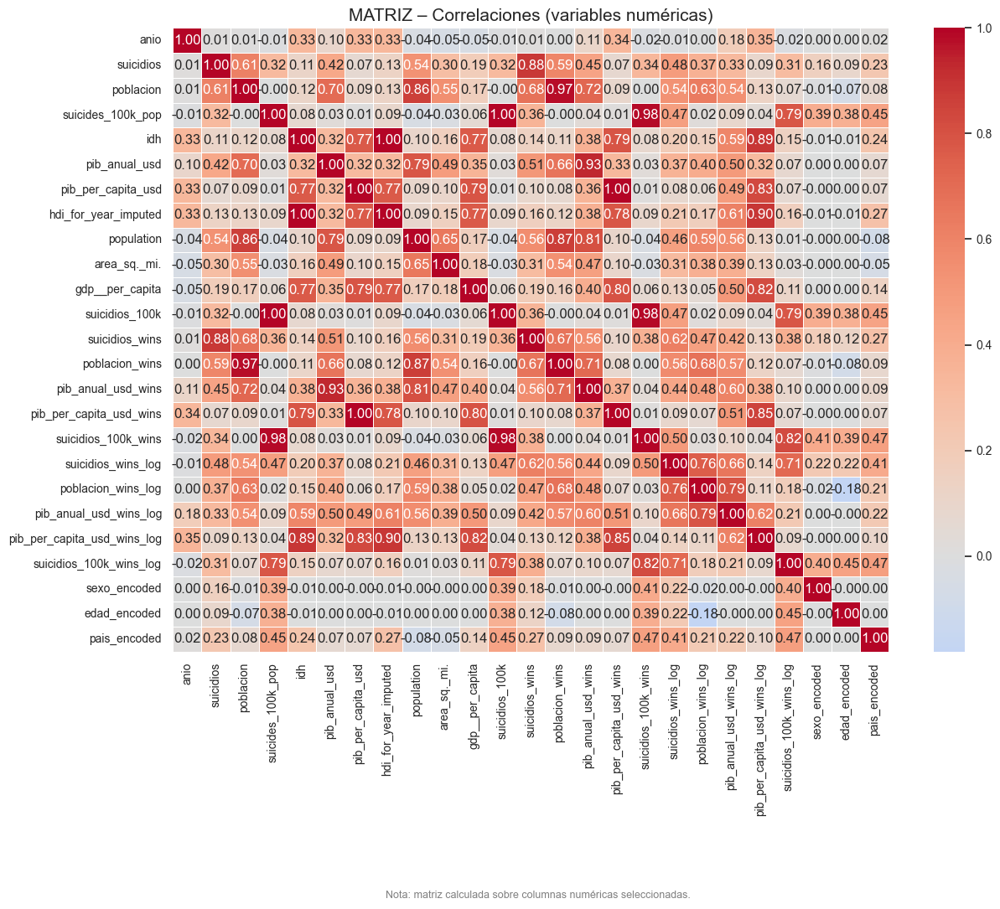

C:\Users\Alex\AppData\Local\Temp\ipykernel_30004\4224271249.py:321: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


C:\Users\Alex\AppData\Local\Temp\ipykernel_30004\4224271249.py:321: UserWarning:


The palette list has fewer values (8) than needed (15) and will cycle, which may produce an uninterpretable plot.



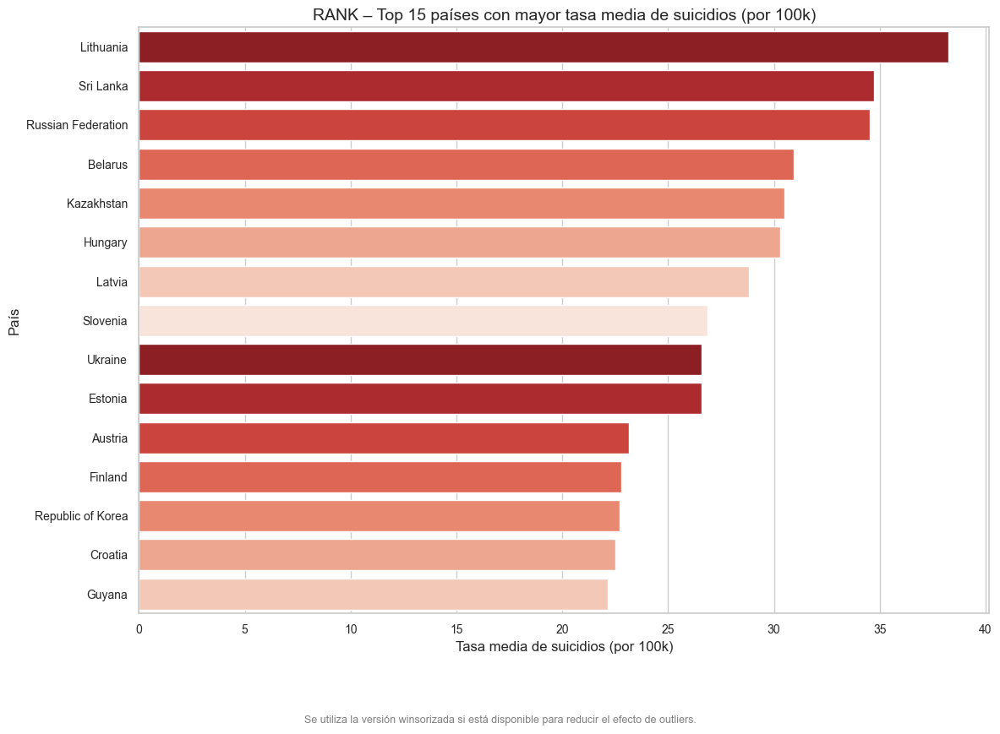

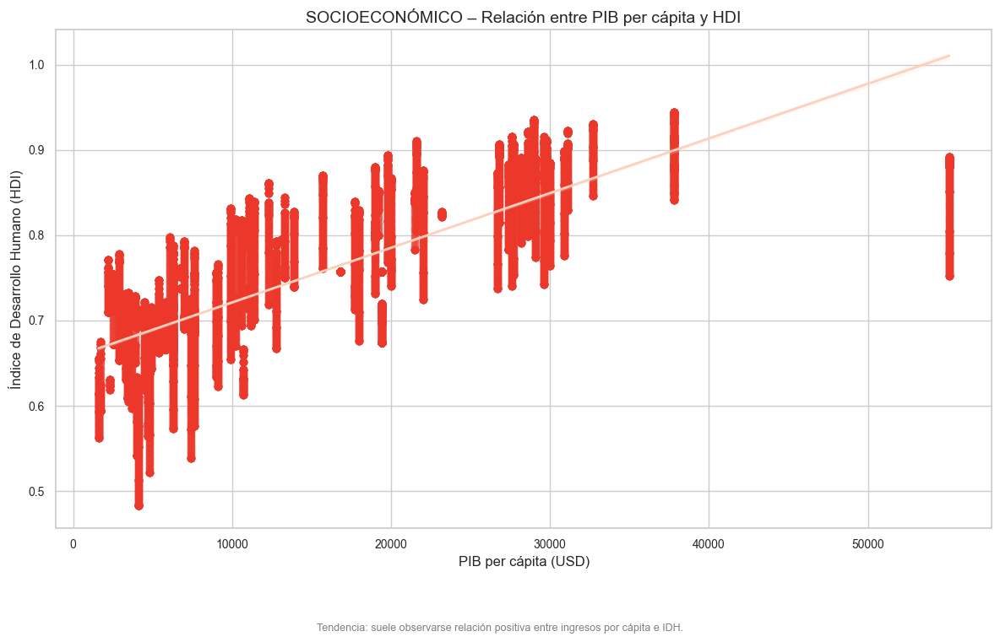

C:\Users\Alex\AppData\Local\Temp\ipykernel_30004\4224271249.py:387: UserWarning:

The palette list has more values (8) than needed (2), which may not be intended.



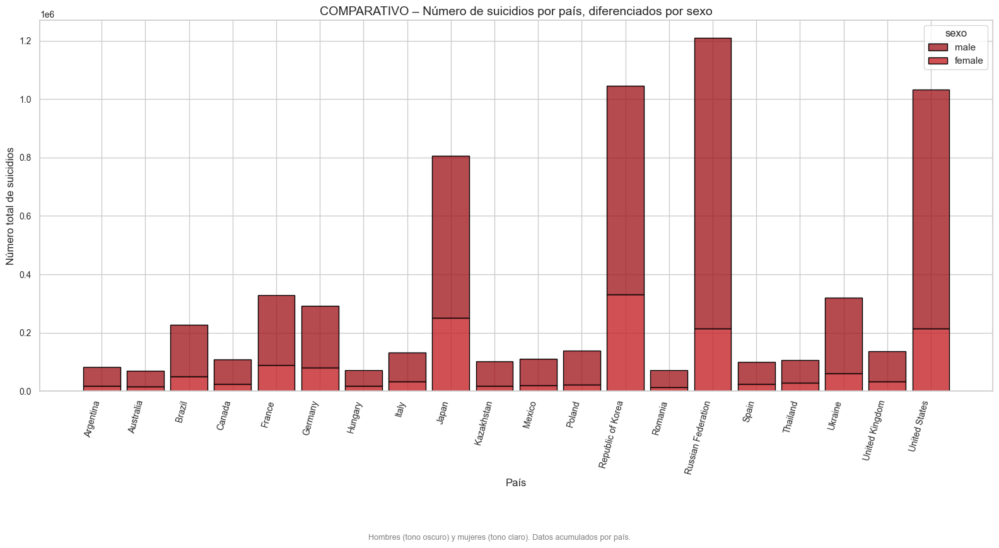

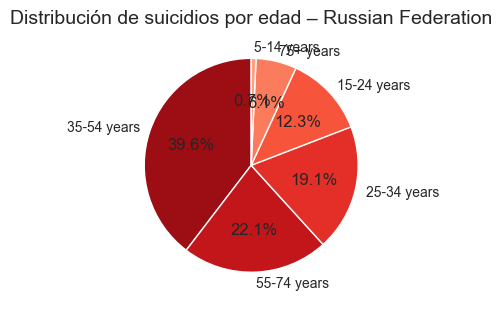

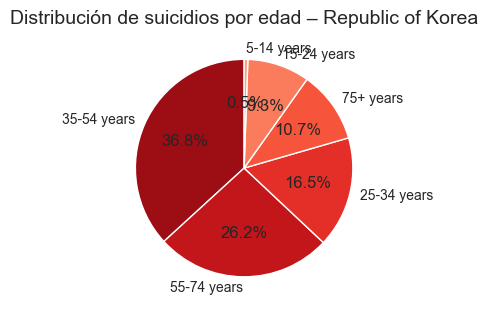

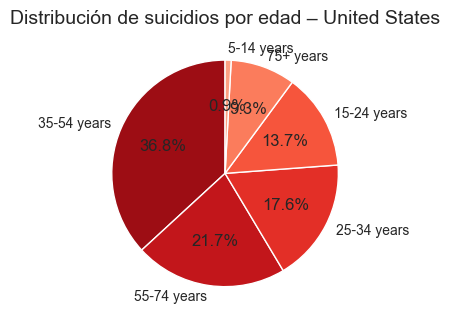

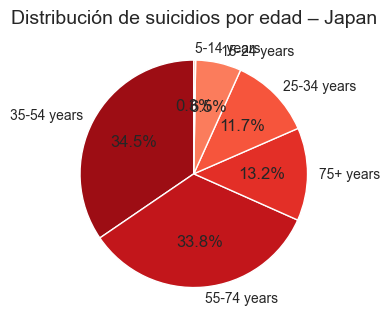

...

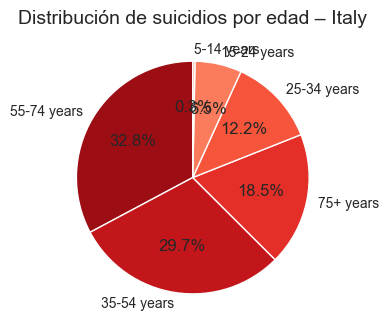

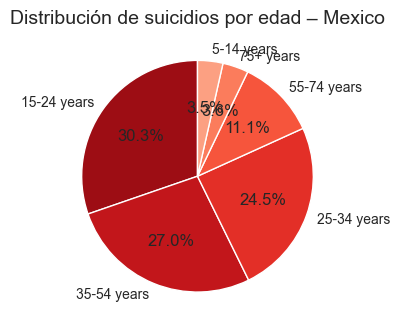

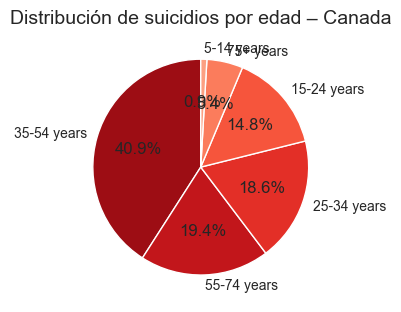

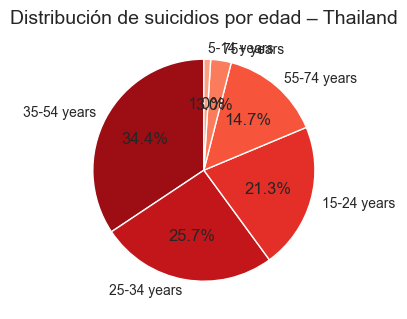

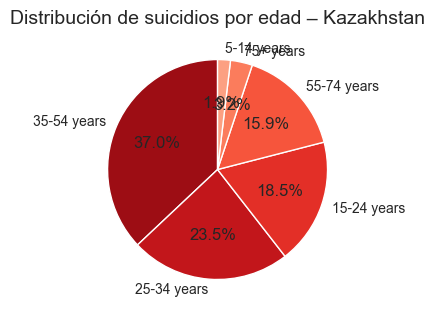

In [ ]:
'''
1. pais
Nombre del país al que corresponde el registro. Identifica la unidad geográfica analizada.

2. anio
Año calendario del registro. Permite realizar análisis temporales, comparaciones entre periodos y series históricas.

3. sexo
Categoría de sexo biológico del grupo poblacional.
Valores habituales: “Male” (hombre) y “Female” (mujer).
Es fundamental para el análisis de brechas de género en la mortalidad por suicidio.

4. edad
Rango etario al que pertenece el grupo poblacional dentro del país y año específicos.
Los rangos típicos son:
5-14 años
15-24 años
25-34 años
35-54 años
55-74 años
75+ años

5. suicidios
Número absoluto de suicidios registrados en ese país-año-sexo-grupo etario.
Corresponde a datos agregados, no individuales.

6. poblacion
Cantidad total de personas pertenecientes al mismo grupo demográfico (país, año, sexo y rango de edad).
Se usa para calcular tasas ajustadas que permiten comparaciones válidas.

7. suicidios_por_100k
Tasa de suicidios por cada 100.000 habitantes dentro del grupo poblacional.
Es el indicador más importante para comparar países y grupos, ya que corrige las diferencias de tamaño poblacional.

8. pais_anio
Etiqueta combinada que une país y año en un único identificador del tipo:
“País_Año” (por ejemplo, “Chile_2005”).
Facilita tareas de agrupamiento y visualización sin aportar información adicional.

9. idh_anual
Índice de Desarrollo Humano (IDH) del país en el año correspondiente.
Es un indicador compuesto que incluye:

salud (esperanza de vida),
educación (años de escolaridad),
nivel de vida (ingreso per cápita).
''' 

from importaciones import *
from funcionesEDA import *

# ---------------------------
# Config
# ---------------------------
INPUT_CSV = "data/master_final.csv"   # <- cámbialo tú si quieres usar el limpio
OUTPUT_CSV = "data/master_final.csv"
CORR_CSV = "data/final_correlation_matrix.csv"
MAP_HTML = "data/mapa_animado.html"
RACE_HTML = "data/race_chart.html"

# ---------------------------
# Apariencia global de gráficos
# ---------------------------
sns.set_theme(style="whitegrid")
palette_base = sns.color_palette("Reds_r", 8)
sns.set_palette(palette_base)
plt.rcParams.update({
    "figure.dpi": 100,
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "xtick.labelsize": 10,
    "ytick.labelsize": 10
})

def add_caption(text, y_offset=-0.08):
    plt.figtext(0.5, y_offset, text, ha="center", fontsize=9, color="gray")

# ---------------------------
# 0) Carga
# ---------------------------
df = pd.read_csv(INPUT_CSV)
df.columns = df.columns.str.strip()

df = df.loc[:, ~df.columns.duplicated()]
print("Columnas iniciales:", df.columns.tolist())

# ---------------------------
# 1) Limpieza inicial y renombrado claro
# ---------------------------
df = df.drop(columns=["country-year"], errors="ignore")

# Primer intento de renombrado (como en tu código original)
df = df.rename(columns={
    "country": "pais",
    "year": "anio",
    "sex": "sexo",
    "age": "edad",
    "suicides_no": "suicidios",
    "population": "poblacion",
    "suicides100k_pop": "suicidios_100k",
    "HDI for year": "idh",
    "gdp_for_year ($)": "pib_anual_usd",
    " gdp_for_year ($) ": "pib_anual_usd",
    "gdp_per_capita ($)": "pib_per_capita_usd",
    "generation": "generacion"
})

df = df.loc[:, ~df.columns.duplicated()]

df["anio"] = pd.to_numeric(df["anio"], errors="coerce")
df = df[(df["anio"] >= 1985) & (df["anio"] <= 2015)]

if "pib_anual_usd" in df.columns:
    df["pib_anual_usd"] = df["pib_anual_usd"].astype(str).str.replace(",", "", regex=False)
    df["pib_anual_usd"] = pd.to_numeric(df["pib_anual_usd"], errors="coerce")

# Normalizar nombres: pasar a minúsculas, reemplazar espacios y símbolos
df.columns = (
    df.columns.str.lower()
    .str.replace(" ", "_")
    .str.replace(r"[()$]", "", regex=True)
    .str.replace("/", "_")
)

# Compatibilidad adicional mínima (no cambia la lógica, solo asegura nombres esperados)
# Si el dataset tiene 'country' o 'country_clean' o 'country' variantes, aseguramos 'pais'
if "country" in df.columns and "pais" not in df.columns:
    df = df.rename(columns={"country": "pais"})
if "country_clean" in df.columns and "country_clean" not in df.columns:
    # no renombramos country_clean; lo dejamos si existe
    pass
# population -> poblacion
if "population" in df.columns and "poblacion" not in df.columns:
    df = df.rename(columns={"population": "poblacion"})
# suicides_no -> suicidios (por si quedó)
if "suicides_no" in df.columns and "suicidios" not in df.columns:
    df = df.rename(columns={"suicides_no": "suicidios"})
# gdp_per_capita ($) ya renombrado, pero si quedó versión con $:
if "gdp_per_capita" in df.columns and "pib_per_capita_usd" not in df.columns:
    df = df.rename(columns={"gdp_per_capita": "pib_per_capita_usd"})

print("Columnas después de normalizar/compatibilizar:", df.columns.tolist())

# ---------------------------
# 2) Tipificación numérica
# ---------------------------
numeric_cols = [
    "anio", "suicidios", "poblacion", "suicidios_100k",
    "idh", "pib_anual_usd", "pib_per_capita_usd"
]

for c in numeric_cols:
    if c in df.columns:
        df[c] = pd.to_numeric(df[c], errors="coerce")

# ---------------------------
# Crear tasa suicidios por 100k si no existe (corrección mínima)
# ---------------------------
# Usamos las columnas disponibles (prioridad a nombres en español ya usados en código).
if "suicidios_100k" not in df.columns:
    # posibles fuentes
    if "suicidios" in df.columns and "poblacion" in df.columns:
        # evitar división por cero
        df["suicidios_100k"] = (df["suicidios"] / df["poblacion"].replace({0: np.nan})) * 100000
    elif "suicides_no" in df.columns and "population" in df.columns:
        df["suicidios_100k"] = (pd.to_numeric(df["suicides_no"], errors="coerce") /
                                pd.to_numeric(df["population"].replace({0: np.nan}), errors="coerce")) * 100000
    else:
        # si no hay datos para construirla, dejamos que el resto del código detecte su ausencia
        pass

# ---------------------------
# 3) Imputación avanzada por país
# ---------------------------
# Asegurar que 'pais' exista para los groupbys: si no, intentar con 'country' o 'country_clean'
if "pais" not in df.columns:
    if "country" in df.columns:
        df = df.rename(columns={"country": "pais"})
    elif "country_clean" in df.columns:
        df = df.rename(columns={"country_clean": "pais"})

# Algunos datasets tienen 'country' capitalizada ('Country') - compatibilizamos también
if "country" in df.columns and "pais" not in df.columns:
    df = df.rename(columns={"country": "pais"})

# Ordenar por pais y anio si existen
sort_cols = []
if "pais" in df.columns:
    sort_cols.append("pais")
if "anio" in df.columns:
    sort_cols.append("anio")
if sort_cols:
    df = df.sort_values(sort_cols)

to_interp = [c for c in ["idh", "pib_anual_usd", "pib_per_capita_usd"] if c in df.columns]

if to_interp and "pais" in df.columns:
    df[to_interp] = df.groupby("pais")[to_interp].transform(
        lambda x: x.interpolate(method="linear").ffill().bfill()
    )

# ---------------------------
# 4) Winsorización
# ---------------------------
def winsorize(series, lower=0.01, upper=0.99):
    ql = series.quantile(lower)
    qh = series.quantile(upper)
    return series.clip(ql, qh)

winsorize_targets = [
    c for c in ["suicidios", "poblacion", "pib_anual_usd",
                "pib_per_capita_usd", "suicidios_100k"]
    if c in df.columns
]

for c in winsorize_targets:
    # Si la columna tiene todo NaN, winsorize podría fallar; protegemos
    if df[c].notnull().any():
        df[c + "_wins"] = winsorize(df[c])
    else:
        df[c + "_wins"] = df[c]  # mantiene NaNs

# ---------------------------
# 5) Fallback fill
# ---------------------------
for c in numeric_cols:
    if c in df.columns and df[c].isnull().any():
        # si toda la columna es NaN, median() será NaN y no cambiará nada
        df[c] = df[c].fillna(df[c].median())

# ---------------------------
# 6) Transformaciones log
# ---------------------------
for base in [c for c in df.columns if c.endswith("_wins")]:
    # evitar log de NaNs o negativos: np.log1p maneja >= -1; winsorize garantiza no extremos
    try:
        df[base + "_log"] = np.log1p(df[base])
    except Exception:
        df[base + "_log"] = np.nan

# ---------------------------
# 7) Encoding categórico
# ---------------------------
if "sexo" in df.columns:
    df["sexo_encoded"] = df["sexo"].map({"male": 1, "female": 0})

age_map = {
    "5-14 years": 1, "15-24 years": 2, "25-34 years": 3,
    "35-54 years": 4, "55-74 years": 5, "75+ years": 6
}

if "edad" in df.columns:
    df["edad_encoded"] = df["edad"].map(age_map)

if "pais" in df.columns and "suicidios_100k_wins" in df.columns:
    country_mean = df.groupby("pais")["suicidios_100k_wins"].mean()
    df["pais_encoded"] = df["pais"].map(country_mean)

# ---------------------------
# 8) Matriz de correlación
# ---------------------------
df_corr = df.select_dtypes(include=[np.number])
corr = df_corr.corr()
corr.to_csv(CORR_CSV)

plt.figure(figsize=(13, 10))
sns.heatmap(corr, cmap="coolwarm", annot=True, fmt=".2f", linewidths=.4, center=0)
plt.title("MATRIZ – Correlaciones (variables numéricas)", fontsize=15)
add_caption("Nota: matriz calculada sobre columnas numéricas seleccionadas.")
plt.tight_layout()
plt.show()

# ---------------------------
# 9) Mapas animados y race chart
# ---------------------------
geo_url = "https://raw.githubusercontent.com/johan/world.geo.json/master/countries.geo.json"
try:
    geojson = requests.get(geo_url).json()
except Exception:
    geojson = None

if {"pais", "anio", "suicidios_100k_wins"}.issubset(df.columns) and geojson is not None:

    mapa_anim = (
        df.groupby(["pais", "anio"], as_index=False)
        .agg(suicidios_prom_100k=("suicidios_100k_wins", "mean"))
        .rename(columns={"pais": "country"})
    )

    fig_map = px.choropleth(
        mapa_anim,
        locations="country",
        geojson=geojson,
        featureidkey="properties.name",
        color="suicidios_prom_100k",
        animation_frame="anio",
        range_color=(0, mapa_anim["suicidios_prom_100k"].max()),
        color_continuous_scale="Reds",
        title="MAPA – Evolución anual de la tasa de suicidios por 100k (1985–2015)"
    )
    fig_map.update_geos(showcountries=True, showcoastlines=True, projection_type="natural earth")
    fig_map.update_layout(margin=dict(r=0, t=40, l=0, b=0))

    try:
        fig_map.show()
    except Exception:
        fig_map.write_html(MAP_HTML)

    rank_anim = (
        mapa_anim.sort_values(["anio", "suicidios_prom_100k"], ascending=[True, False])
        .groupby("anio")
        .head(15)
    )

    fig_race = px.bar(
        rank_anim,
        x="suicidios_prom_100k",
        y="country",
        orientation="h",
        color="country",
        animation_frame="anio",
        range_x=[0, mapa_anim["suicidios_prom_100k"].max()],
        title="RACE – TOP 15 países por tasa de suicidios (1985–2015)"
    )
    fig_race.update_yaxes(autorange="reversed")

    try:
        fig_race.show()
    except Exception:
        fig_race.write_html(RACE_HTML)

# ============================================================
# TOP 15 PAÍSES POR TASA MEDIA DE SUICIDIOS
# ============================================================
# Aseguramos que exista la columna objetivo; si no, intentamos con lo que haya
if "suicidios_100k_wins" in df.columns:
    target_col_top = "suicidios_100k_wins"
elif "suicidios_100k" in df.columns:
    target_col_top = "suicidios_100k"
elif "suicides_no" in df.columns and "population" in df.columns:
    # fallback: crear temporalmente la tasa y usarla
    df["suicidios_100k_tmp"] = (pd.to_numeric(df["suicides_no"], errors="coerce") /
                                pd.to_numeric(df["population"].replace({0: np.nan}), errors="coerce")) * 100000
    target_col_top = "suicidios_100k_tmp"
else:
    # si no hay ninguna, lanzamos aviso y evitamos el error
    print("Aviso: no hay columna disponible con tasa de suicidios para calcular el TOP 15.")
    target_col_top = None

if target_col_top is not None:
    # Agrupamos por 'pais' (compatibilizamos si la columna no existe)
    groupby_country_col = "pais" if "pais" in df.columns else ("country" if "country" in df.columns else None)
    if groupby_country_col is None:
        print("Aviso: no se encontró columna de país para agrupar (ni 'pais' ni 'country'). Se suprime el Top 15.")
    else:
        top15 = (
            df.groupby(groupby_country_col)[target_col_top]
              .mean()
              .sort_values(ascending=False)
              .head(15)
        )

        plt.figure(figsize=(12, 8))
        sns.barplot(x=top15.values, y=top15.index, palette=palette_base)
        plt.title("RANK – Top 15 países con mayor tasa media de suicidios (por 100k)", fontsize=14)
        plt.xlabel("Tasa media de suicidios (por 100k)")
        plt.ylabel("País")
        add_caption("Se utiliza la versión winsorizada si está disponible para reducir el efecto de outliers.")
        plt.tight_layout()
        plt.show()

# ============================================================
# GRAFICO: RELACIÓN HDI vs PIB PER CÁPITA
# ============================================================
# Detección robusta de columnas HDI/GDP: preferimos idh / pib_per_capita_usd,
# pero aceptamos variantes como 'hdi_for_year_imputed' o 'gdp__per_capita' si existen.
possible_hdi = ["hdi_clean", "idh", "hdi_for_year_imputed", "hdi_for_year"]
possible_gdp = ["gdp__per_capita", "pib_per_capita_usd", "gdp_per_capita"]

hdi_col = next((c for c in possible_hdi if c in df.columns), None)
gdp_col = next((c for c in possible_gdp if c in df.columns), None)

if hdi_col and gdp_col:
    df_plot = df.dropna(subset=[hdi_col, gdp_col])
    reds = sns.color_palette("Reds_r", 10)

    plt.figure(figsize=(12, 7))
    sns.regplot(
        data=df_plot,
        x=gdp_col,
        y=hdi_col,
        scatter_kws={"alpha": 0.35, "color": reds[3]},
        line_kws={"color": reds[8], "linewidth": 2}
    )

    plt.title("SOCIOECONÓMICO – Relación entre PIB per cápita y HDI", fontsize=14)
    plt.xlabel("PIB per cápita (USD)")
    plt.ylabel("Índice de Desarrollo Humano (HDI)")
    add_caption("Tendencia: suele observarse relación positiva entre ingresos por cápita e IDH.")
    plt.tight_layout()
    plt.show()
else:
    print("Aviso: no se encontraron columnas válidas para HDI vs PIB per cápita:", hdi_col, gdp_col)

# ============================================================
# SUICIDIOS POR PAÍS DIFERENCIADOS POR SEXO
# ============================================================
# Usamos 'pais' preferentemente, si no existe, 'country'
groupby_country_col = "pais" if "pais" in df.columns else ("country" if "country" in df.columns else None)
if groupby_country_col is None:
    print("Aviso: no se encontró columna de país para el gráfico por sexo.")
else:
    # Aseguramos que exista la columna 'suicidios' antes de agrupar; si no, intentamos usar 'suicides_no'
    suicidios_col_for_plot = "suicidios" if "suicidios" in df.columns else ("suicides_no" if "suicides_no" in df.columns else None)

    if suicidios_col_for_plot is None:
        print("Aviso: no se encontró columna con número de suicidios para el gráfico por sexo.")
    else:
        top_countries = (
            df.groupby(groupby_country_col)[suicidios_col_for_plot]
              .sum()
              .sort_values(ascending=False)
              .head(20)
              .index
        )

        df_plot = df[df[groupby_country_col].isin(top_countries)]

        plt.figure(figsize=(16, 8))
        sns.histplot(
            data=df_plot,
            x=groupby_country_col,
            hue="sexo" if "sexo" in df_plot.columns else None,
            weights=suicidios_col_for_plot,
            multiple="stack",
            palette=palette_base,
            shrink=0.85,
            edgecolor="black"
        )

        plt.xticks(rotation=75, ha="right")
        plt.title("COMPARATIVO – Número de suicidios por país, diferenciados por sexo", fontsize=14)
        plt.ylabel("Número total de suicidios")
        plt.xlabel("País")
        add_caption("Hombres (tono oscuro) y mujeres (tono claro). Datos acumulados por país.")
        plt.tight_layout()
        plt.show()



 # ----------------------------------------------------
# Top 15 países por número total de suicidios
# ----------------------------------------------------
top15 = (
    df.groupby("pais")["suicidios"]
      .sum()
      .sort_values(ascending=False)
      .head(15)
      .index
)

df_top15 = df[df["pais"].isin(top15)]

# ----------------------------------------------------
# Crear gráficos de pastel distribuidos por edad
# ----------------------------------------------------
for pais in top15:
    sub = (
        df_top15[df_top15["pais"] == pais]
        .groupby("edad")["suicidios"]
        .sum()
        .sort_values(ascending=False)
    )
    
    # Evitar errores si un país no tiene alguna categoría de edad
    sub = sub[sub > 0]

    plt.figure(figsize=(3, 3))
    plt.pie(
        sub.values,
        labels=sub.index,
        autopct="%1.1f%%",
        startangle=90
    )
    plt.title(f"Distribución de suicidios por edad – {pais}")
    plt.tight_layout()
    plt.show()      